# Andrea Fernanda Campos Pérez

## Modelo FitzHugh-Nagumo
### Sistemas dinámicos II / Dynamic Systems II
***

## Coding the FitzHugh-Nagumo model with Euler

Equations are
\begin{align}
\dot x&=-x^3/3+x-y+I\\
      &=-I_{ion}(x,y)+I,\quad I_{ion}(x,y)=x^3-x+y\\
\dot y&=\varepsilon(x-y)
\end{align}

In [1]:
using Plots

In [2]:
T=500  #tiempo final, habran 500 tiempos
dt=0.001  #Paso del tiempo
Nt=convert(Int64,T/dt)+1  #Cuantos bines de tiempo son, es decir, se divide el total de tiempos entre el paso dt
t=range(0,T,length=Nt)  #Vector de tiempos

function FHNeuler(I,ε,x0,y0)   #Función para resolver las ec. FHN con euler
    x=zeros(Nt,1)
    y=zeros(Nt,1)
    x[1]=x0  #Condiciones iniciales
    y[1]=y0
    for i=2:Nt
        x[i]=x[i-1]+dt*(-(x[i-1]^3)/3+x[i-1]-y[i-1]+I)  #Ecuacion de x
        y[i]=y[i-1]+dt*ε*(x[i-1]-y[i-1])   #Ecuacion en y
    end
    return x,y
end

FHNeuler (generic function with 1 method)

### Stable state of the FHN model
#### The following parameters and initial conditions allow the FHN model to simulate a single spike

In [3]:
I=-0.41 #Corriente aplicada que da una dinámica neuronal estable

ε=0.05  
        
x0=0.0 #randn(1)[1]   Condiciones iniciales, pueden ser aleatorias
y0=-1.0 #randn(1)[1]

@time x,y=FHNeuler(I,ε,x0,y0);  #llamamos a la función y guardamos el output en variables x y

  0.607023 seconds (15.52 M allocations: 253.219 MiB, 4.83% gc time)


In [4]:
#Plot de los vectores solucion de las ecuaciones FHN, dado I=-0.41
plot(t,x,label="x", linewidth=4, ylabel="Voltage (mV)",xlabel="Time (ms)", title= "FitzHugh-Nagumo model")
plot!(t,y,label="y", linewidth= 2)  #El signo de admiración indica que las gráficas estarán juntas

## Coding the FitzHugh-Nagumo model with Differential Equations

In [4]:
using DifferentialEquations

In [5]:
function FHNdiffEq(du,u,p,t)
    I=p[1]
    ε=p[2]
    x=u[1]
    y=u[2]
    du[1]=-x^3/3+x-y+I
    du[2]=ε*(x-y)
end

FHNdiffEq (generic function with 1 method)

### Stable state of the FHN model
#### The following parameters and initial conditions allow the FHN model to simulate a single spike

In [6]:
T=500.0
tspan=(0.0,T)

I=-0.41
ε=0.05

x0=0.0 #randn(1)[1]
y0=-1.0 #randn(1)[1]

p=(I,ε)
prob = ODEProblem(FHNdiffEq,[x0;y0],tspan,p)
@time sol = solve(prob,reltol=10e-9,abstol=10e-9,AutoTsit5(Rosenbrock23())); ## See Julia Diff EQ page

 16.970913 seconds (47.64 M allocations: 2.319 GiB, 6.79% gc time)


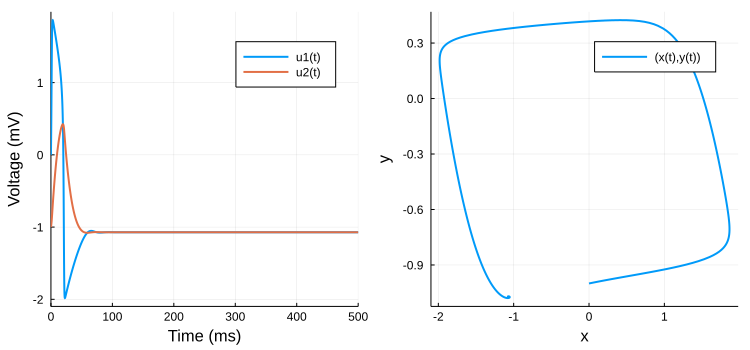

In [7]:
p1= plot(sol, linewidth= 2, xlabel="Time (ms)", ylabel="Voltage (mV)")
p2= plot(sol[1,:],sol[2,:],label="(x(t),y(t))",xlabel="x",ylabel="y", linewidth=2)

plot(p1,p2, layout=(1,2), size=(750,350))

## FHN phase portrait in stable state

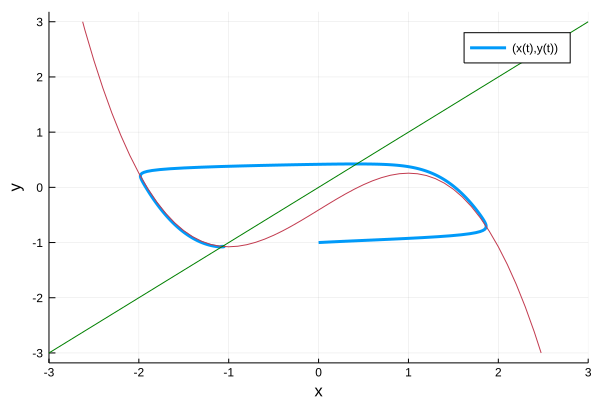

In [8]:
x = -3:0.1:3
y = -3:0.1:3
Xnullcline(x,y)=-x^3/3+x-y+I
Ynullcline(x,y)=x-y
plot(sol,vars=(1,2),label="(x(t),y(t))",xlabel="x",ylabel="y", xlim=(-3.0, 3), linewidth= 3)
contour!(x,y,Xnullcline,levels=[0])
contour!(x,y,Ynullcline,levels=[0],colorbar=false, color= "green")

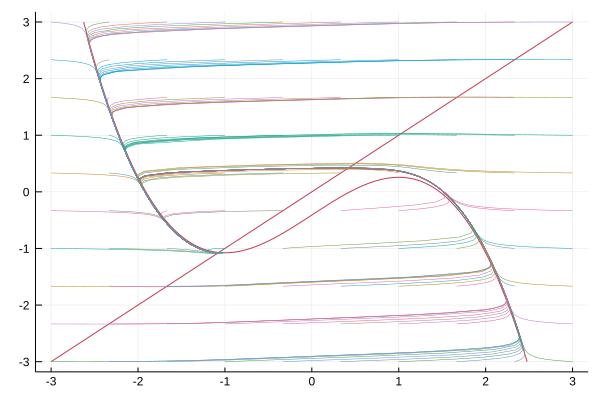

In [9]:
#FHN phase portraits with different initial values for x and y
x = -3:0.01:3
y = -3:0.01:3
Xnullcline(x,y)=-x^3/3+x-y+I
Ynullcline(x,y)=x-y
contour(x,y,Xnullcline,levels=[0])
contour!(x,y,Ynullcline,levels=[0],colorbar=false)

for x0 in range(-3,3,length=10)
    for y0 in range(-3,3,length=10)
        prob = ODEProblem(FHNdiffEq,[x0;y0],tspan,p)
        sol = solve(prob)
        plot!(sol[1,:],sol[2,:],lw=0.5,legend=false)
    end
end
plot!()


***
# Part 1: Hopf Bifurcation of FHN model

>Approximate the value of $I_{Hopf}$ at which the model undergoes a Hopf bifurcation. How does $I_{Hopf}$ depend on $\varepsilon$? For instance, does $I_{Hopf}$ increase or decrease as $\varepsilon$ increases? Use simulations and, possibly, linear algebra to justify your answer.

## 1.1 Hopf bifurcation

#### Definitions:
***
A Hopf bifurcation is a critical point where a system's stability switches and a periodic solution arises.
The appearance or the disappearance of a periodic orbit through a local change in the stability properties of a fixed point is known as the Hopf bifurcation.
<br>
<br>
In the Andronov-Hopf bifurcation the resting state in a neuronal model does not disappear, but it loses stability. 
This loss of stability is accompanied by one of the following two dynamics:
<br>
<br>
1) The apperance of a stable limit cycle appearing from a stable equilibrium (i.e. __supercritical Andronov Hopf__).
<br>
2) The disapperance of an unstable limit cycle to a stable fixed equilibrium (i.e. __subcritical Andronov Hopf__).
<br> <br> ___The next bifurcation diagram corresponds to the Supercritical (left) or Subcritical (right) Andronov-Hopf bifurcation, taken from Izhikevich, E. 2007.___ 
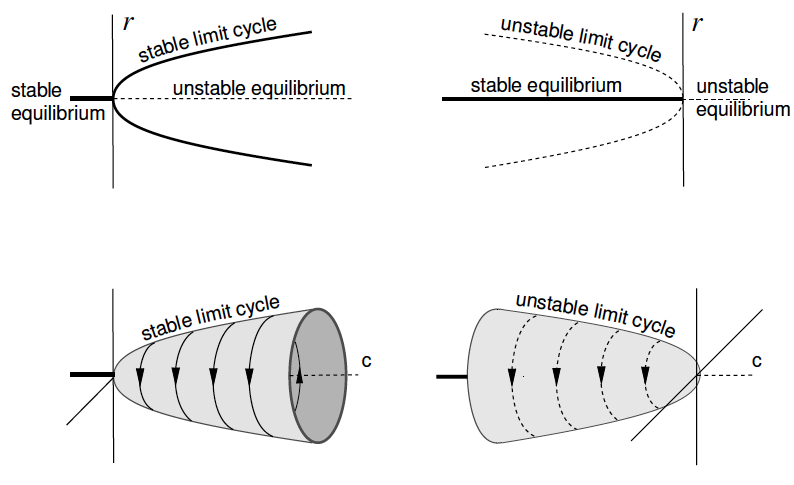


A neuron is excitable because its resting state is near a bifurcation, i.e. transition from resting to periodic spiking. Such bifurcation (transition) can be revealed by applying a ramp of current. 
<br><br>___The following figure shows the transition from the resting state to repetitive spiking via Andronov-Hopf bifurcation.___ Top figure is taken from Izhikevich, 2007. Bottom figure shows the dynamics that I found simulating a current ramp in the FHN model.
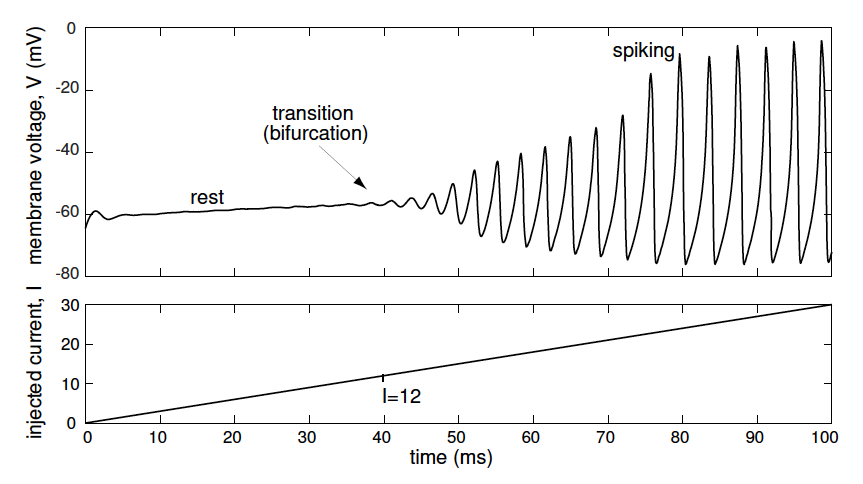
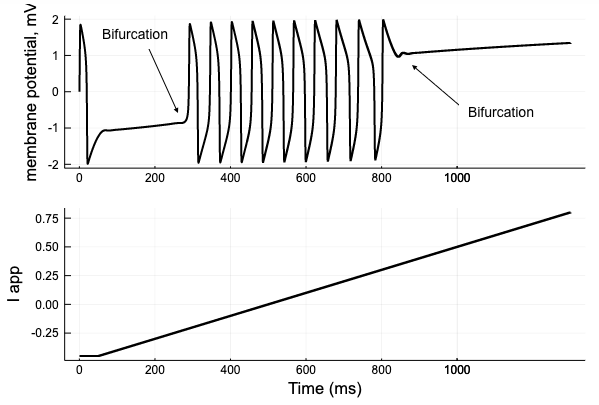

## 1.2 Supercritical Andronov-Hopf bifurcation
***
In this section I simulate the supercritical Hopf bifurcation.
<br> I focused on this type of Hopf bifurcation because according to the literature it is the one that appears most commonly in neurons and their models. Furthermore, subcritical Hopf is reported to be more difficult and unusual to find.

>Through various simulations and based on previous literature, I found that $I_{Hopf} = -0.3147$ in the FitzHugh Nagumo model.

In [10]:
T=500.0
tspan=(0.0,T)

#Aquí voy a establecer 5 simulaciones, la I1 corresponde a la bifurcación de HOPF Super, I4 al resting state del modelo, previamente visto. 
#Las otras tres simulaciones corresponden a la transicion del resting a la bifurcacion, esto se logra disminuyendo la corriente aplicada.
#En I=0 estamos en el estado oscilatorio del sistema 

I0= 0.0  #Estado oscilatorio
I1= -0.3147  #HOPF super
I2= -0.31475 
I3= -0.33
I4= -0.41 #Resting State

#Es importante notar que el sistema FHN es SIMÉTRICO, así que si cambiamos los signos de I1 a I5, observaremos el
#mismo comportamiento solo que en el dominio positivo.
#Me dediqué a simular en el dominio negativo porque es fisiológicamente donde tiene sentido el comportamiento.
#Claro, pensando que el potencial de membrana de la neurona oscila entre -40 y -60 mV.

ε=0.05

x0=0.0
y0=-1.0

p0=(I0,ε)
p1=(I1,ε)
p2=(I2,ε)
p3=(I3,ε)
p4=(I4,ε)

prob0 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p0)
prob1 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p1)
prob2 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p2)
prob3 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p3)
prob4 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p4)

@time sol0 = solve(prob0,reltol=10e-9,abstol=10e-9,AutoTsit5(Rosenbrock23())); 
@time sol1 = solve(prob1,reltol=10e-9,abstol=10e-9,AutoTsit5(Rosenbrock23())); 
@time sol2 = solve(prob2,reltol=10e-9,abstol=10e-9,AutoTsit5(Rosenbrock23())); 
@time sol3 = solve(prob3,reltol=10e-9,abstol=10e-9,AutoTsit5(Rosenbrock23())); 
@time sol4 = solve(prob4,reltol=10e-9,abstol=10e-9,AutoTsit5(Rosenbrock23())); 

  0.002960 seconds (22.51 k allocations: 2.192 MiB)
  0.002122 seconds (18.50 k allocations: 1.806 MiB)
  0.001480 seconds (9.32 k allocations: 926.875 KiB)
  0.001021 seconds (5.46 k allocations: 539.375 KiB)
  0.001044 seconds (3.53 k allocations: 338.375 KiB)


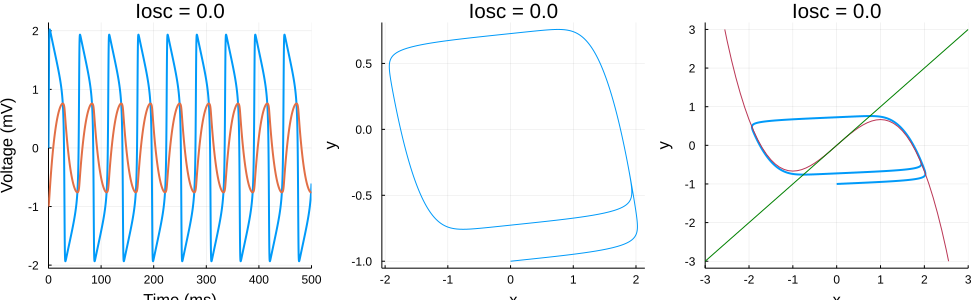

In [12]:
#Iosc=0.0
x = -3:0.1:3
y = -3:0.1:3
Xnullcline(x,y)=-x^3/3+x-y+I0
Ynullcline(x,y)=x-y

p1= plot(sol0, linewidth= 2, ylabel="Voltage (mV)", xlabel= "Time (ms)")
p2=plot(sol0[1,:],sol0[2,:],label="(x(t),y(t))",xlabel="x",ylabel="y")
p3=plot(sol0,vars=(1,2),label="(x(t),y(t))",xlabel="x",ylabel="y", xlim=(-3.0, 3), linewidth=2, size=(500,400))
p3=contour!(x,y,Xnullcline,levels=[0])
p3=contour!(x,y,Ynullcline,levels=[0],colorbar=false, color="green")

plot(p1, p2, p3, layout=(1,3), legend= false,size=(980,300), title="Iosc = 0.0")

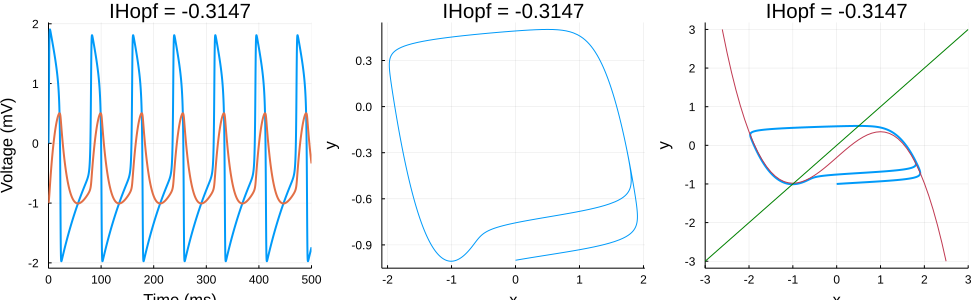

In [13]:
#IHopf = -0.3147
x = -3:0.1:3
y = -3:0.1:3
Xnullcline(x,y)=-x^3/3+x-y+I1
Ynullcline(x,y)=x-y

p1= plot(sol1, linewidth= 2, ylabel="Voltage (mV)", xlabel= "Time (ms)")
p2=plot(sol1[1,:],sol1[2,:],label="(x(t),y(t))",xlabel="x",ylabel="y")
p3=plot(sol1,vars=(1,2),label="(x(t),y(t))",xlabel="x",ylabel="y", xlim=(-3.0, 3), linewidth=2, size=(500,400))
p3=contour!(x,y,Xnullcline,levels=[0])
p3=contour!(x,y,Ynullcline,levels=[0],colorbar=false, color="green")

plot(p1, p2, p3, layout=(1,3), legend= false,size=(980,300), title= "IHopf = -0.3147")

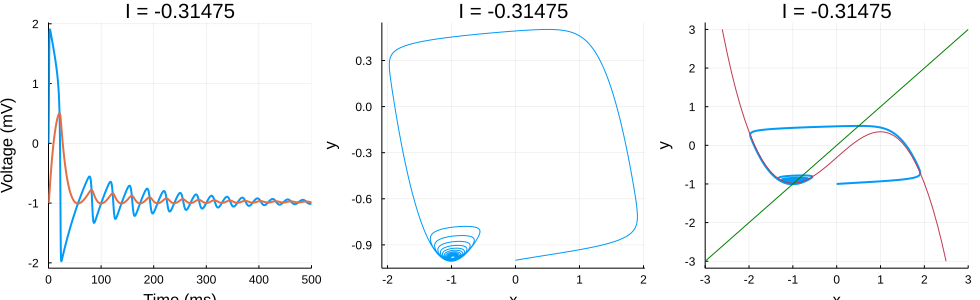

In [14]:
#I = -0.31475
x = -3:0.1:3
y = -3:0.1:3
Xnullcline(x,y)=-x^3/3+x-y+I2
Ynullcline(x,y)=x-y

p1= plot(sol2, linewidth= 2, ylabel="Voltage (mV)", xlabel= "Time (ms)")
p2=plot(sol2[1,:],sol2[2,:],label="(x(t),y(t))",xlabel="x",ylabel="y")
p3=plot(sol2,vars=(1,2),label="(x(t),y(t))",xlabel="x",ylabel="y", xlim=(-3.0, 3), linewidth=2, size=(500,400))
p3=contour!(x,y,Xnullcline,levels=[0])
p3=contour!(x,y,Ynullcline,levels=[0],colorbar=false, color="green")

plot(p1, p2, p3, layout=(1,3), legend= false, size=(980,300), title= "I = -0.31475")

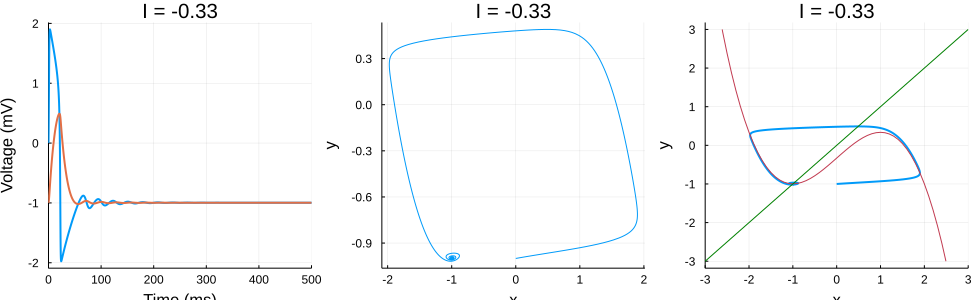

In [15]:
#I= -0.33
x = -3:0.1:3
y = -3:0.1:3
Xnullcline(x,y)=-x^3/3+x-y+I3
Ynullcline(x,y)=x-y

p1= plot(sol3, linewidth= 2, ylabel="Voltage (mV)", xlabel= "Time (ms)")
p2=plot(sol3[1,:],sol3[2,:],label="(x(t),y(t))",xlabel="x",ylabel="y")
p3= plot(sol3,vars=(1,2),label="(x(t),y(t))",xlabel="x",ylabel="y", xlim=(-3.0, 3), linewidth=2, size=(500,400))
p3=contour!(x,y,Xnullcline,levels=[0])
p3=contour!(x,y,Ynullcline,levels=[0],colorbar=false, color="green")

plot(p1, p2,p3, layout=(1,3), legend= false,size=(980,300), title= "I = -0.33")

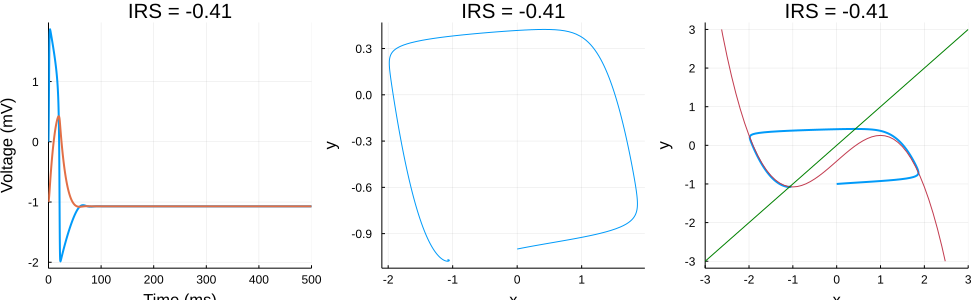

In [17]:
#I RS= -0.41
x = -3:0.1:3
y = -3:0.1:3
Xnullcline(x,y)=-x^3/3+x-y+I4
Ynullcline(x,y)=x-y

p1= plot(sol4, linewidth= 2, ylabel="Voltage (mV)", xlabel= "Time (ms)")
p2=plot(sol4[1,:],sol4[2,:],label="(x(t),y(t))",xlabel="x",ylabel="y")
p3=plot(sol4,vars=(1,2),label="(x(t),y(t))",xlabel="x",ylabel="y", xlim=(-3.0, 3), linewidth=2, size=(500,400))
p3=contour!(x,y,Xnullcline,levels=[0])
p3=contour!(x,y,Ynullcline,levels=[0],colorbar=false, color="green")

plot(p1, p2,p3, layout=(1,3), legend= false, size=(980,300), title= "IRS = -0.41")

<br>__The following figure shows the transition of the FitzHugh Nagumo model from the Resting State ($I_{RS} = -0.6$) to the oscillatory state ($I_{OSC} = 0.0$) passing through the Supercritical Hopf bifurcation ($I_{Hopf} = -0.3147$).__ As the bifurcation parameter $I$ increases, the stable equilibrium loses stability and gives birth to a stable limit cycle with growing amplitude. Also shown is the __bifurcation diagram__ of the simulated process (bottom right), taken from Izhikevich, E. 2007.

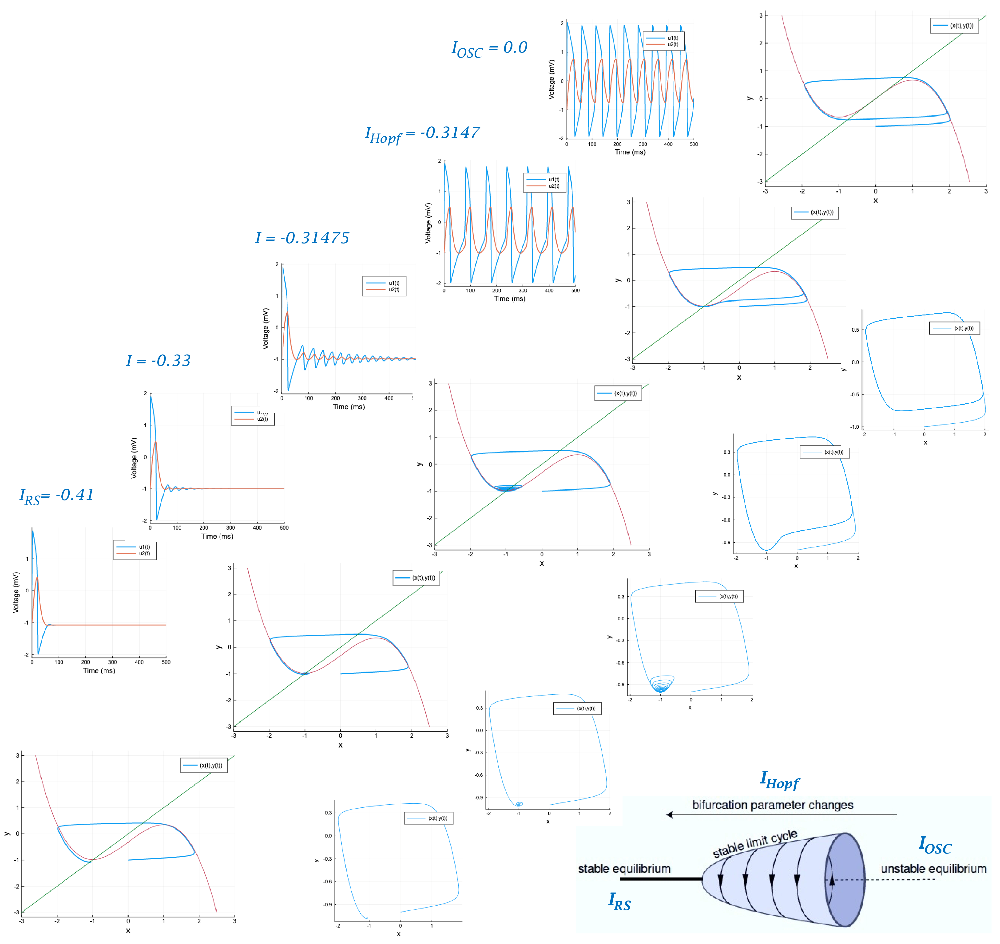

## 1.3 Dependence of $I_{Hopf}$ on $\varepsilon$

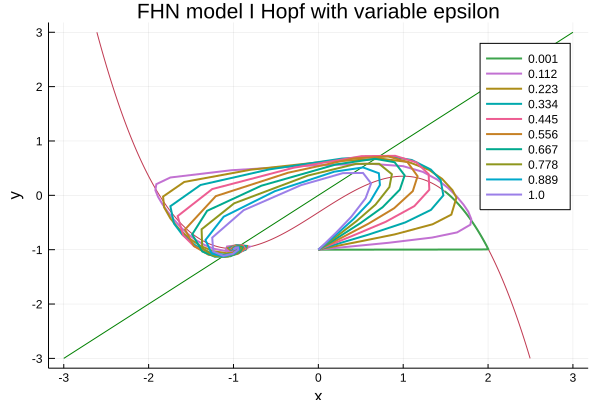

In [18]:
T=500.0
tspan=(0.0,T)

I=-0.3147  #Hopf bifurcation I parameter

x0= 0.0
y0= -1.0

x = -3:0.01:3
y = -3:0.01:3
Xnullcline(x,y)=-x^3/3+x-y+I
Ynullcline(x,y)=x-y
contour(x,y,Xnullcline,levels=[0])
contour!(x,y,Ynullcline,levels=[0],colorbar=false, color="green")

for ε in range(0.001,1,length=10)
    p= (I,ε)
    prob = ODEProblem(FHNdiffEq,[x0;y0],tspan,p)
    sol = solve(prob)
    plot!(sol[1,:],sol[2,:],lw=2, label= ε, title="FHN model I Hopf with variable epsilon", xlabel="x", ylabel="y")
end

plot!()

__Dynamics of the FHN model at the Hopf bifurcation with different values of $\varepsilon$__
<br> First, we must remember that $\varepsilon$ is found in the FHN model in the following equation $\dot y=\varepsilon(x-y)$. This tells us that the value of epsilon acts as a "scaler" of the equation $\dot y$, that is, its value causes the equation to increase or decrease, which translates into fast or slow dynamics of the variable $y$ in the model, respectively.
<br>
>Therefore, the value of $\varepsilon$ is important because it dictates the kinetics of the recovery variable $y$, and therefore the dynamics of the system.
<br>

With this in mind, we can now analyze what happens to the system dynamics at the Hopf bifurcation, and thus find how the value $I_{Hopf}$ depends on $\varepsilon$.

- Firstly, at the minimum value of $\varepsilon$ (0.001), the evolution of the system stops when it hits the right arm of the cubic nullcline of $x$. This happens because when $x = 0$ (i.e. nullcline), the entire dynamics of the system depends on $y$, and because it is so small given the value of $\varepsilon$, it will not make the model advance. Therefore, at small $\varepsilon$ values, $I_{Hopf}$ does not exist. In physiological terms, the neuron remains in a sustained depolarization that never reaches the resting state.
- Since the value of $\varepsilon= 0.112$, the equilibrium of the system is a __stable focus__ corresponding to the resting state. Furthermore, the increase in $\varepsilon > 0.112$ is proportional to the increase in the speed with which the system completes the trajectory. This is because as the value of the recovery variable $y$ increases, it exceeds the contribution of the activation variable $x$ in the dynamics of the system. If $\varepsilon$ increases more, the dynamics of the system will depend solely on $y$. Finally, if we wanted to observe $I_{Hopf}$ again, the value of the applied current $I$ must increase proportionally to the increase in $\varepsilon$.
<br>Physiologically, the latter translates into how fast the neuron reaches the resting state and whether it will be able to generate a typical or "atypical" spike, or none at all. I infer this because when $\varepsilon >= 0.223$, the neural dynamics no longer describe the orbit necessary to generate a typical spike.
<br>
<br>
In conclusion, the appearance of $I_{Hopf}$ depends on $\varepsilon$ in the following way: when $\varepsilon < 0.05$ the Hopf bifurcation does not exist because the dynamics of the system is truncated at the beginning; when $\varepsilon = 0.05$, the Hopf bifurcation is given at $I = -0.3147$ (as we have seen), let us consider that this $\varepsilon$ is the optimal one for $I_{Hopf}$; finally when $\varepsilon > 0.05$, the Hopf bifurcation disappears and the equilibrium becomes a stable focus, to find the bifurcation of Hopf $I_{app} > -0.3147$, and increase proportionally to the increase in $\varepsilon$.

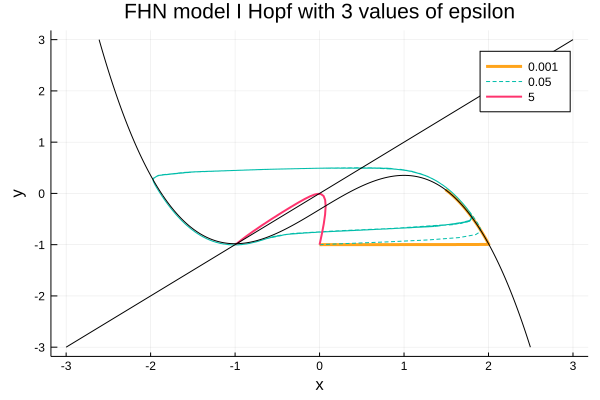

In [30]:
#3 more simulations, one with a very small epsilon (0.001), a "normal" epsilon (0.05) and lastly, with a big epislon value (5)
T=500.0
tspan=(0.0,T)

I=-0.3147  #Hopf bifurcation I parameter

x0= 0.0
y0= -1.0

ε1= 0.001
ε2= 0.05
ε3= 5

p1= (I,ε1)
p2= (I,ε2)
p3= (I,ε3)

prob1 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p1)
prob2 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p2)
prob3 = ODEProblem(FHNdiffEq,[x0;y0],tspan,p3)

sol1 = solve(prob1)
sol2 = solve(prob2)
sol3 = solve(prob3)

#Plot phase portrait
x = -3:0.01:3
y = -3:0.01:3
Xnullcline(x,y)=-x^3/3+x-y+I
Ynullcline(x,y)=x-y

plot(sol1[1,:],sol1[2,:],lw=3, label= ε1, title="FHN model I Hopf with 3 values of epsilon", xlabel="x", ylabel="y", color= "#ffa41b")
plot!(sol2[1,:],sol2[2,:], lw=1, label= ε2, color="#00bdaa", ls= :dash)
plot!(sol3[1,:],sol3[2,:],lw=2, label= ε3, color="#fe346e")
contour!(x,y,Xnullcline,levels=[0], color="black")
contour!(x,y,Ynullcline,levels=[0],colorbar=false, color="black")

__Dynamics of the FHN model at the Hopf bifurcation given 3 values of $\varepsilon$.__
<br>In this figure we can easily observe the dependence of $I_{Hopf}$ with more "notable" $\varepsilon$ values.
When $\varepsilon = 0.001$ (yellow), the system is truncated at the zerocline of $x$, as in the previous graph, and therefore, the Hopf bifurcation does not exist.
When $\varepsilon = 0.05$ (blue), the Hopf bifurcation occurs at $I = -0.3147$, as we have been seeing throughout the exercise.
Finally, when $\varepsilon = 5$ (pink), the bifurcation disappears and the trajectory of the system from the initial conditions to the stable fixed point is almost instantaneous. If we wanted to retrieve $I_{Hopf}$, the applied current $I >>> -0.3147$.

***
# Part 2: Steps and train of pulses

>Modify the code to be able to apply steps of applied currents and train of current pulses with variable amplitude, frequency and duty cycle. Simulate the model for current steps of various amplitude and for pulse trains of various amplitude, frequency, and duty cycle. Describe the observed behavior.

## 2.1 Steps of applied currents

In [32]:
#Función para el pulso (step) de corriente
STEP(t,tstep,Istep)=(sign(t-tstep)+1)/2*Istep

STEP (generic function with 1 method)

In [33]:
T=500  
dt=0.001  
Nt=convert(Int64,T/dt)+1  
t=range(0,T,length=Nt) 

function FHNeulerSTEP(I, ε, x0, y0, tstep, Istep)   
    """Función para resolver las ec. FHN con euler, 
    con la capacidad de aplicar pulsos de corriente (steps) 
    Argumentos:
    I= corriente aplicada inicial
    ε= variable que controla la "velocidad" de evolución de y
    x0= condición inicial del sistema en x
    y0= condición inicial del sistema en y
    tstep= tiempo en el cual se dará el pulso de corriente
    Istep= corriente del pulso
    """
    x=zeros(Nt,1)
    y=zeros(Nt,1)
    x[1]=x0  
    y[1]=y0
    for i=2:Nt
        tin= i*dt
        x[i]=x[i-1]+dt*(-(x[i-1]^3)/3+x[i-1]-y[i-1]+I+ STEP(tin, tstep,Istep))
        y[i]=y[i-1]+dt*ε*(x[i-1]-y[i-1])
    end
    return x,y
end

FHNeulerSTEP (generic function with 1 method)

In [34]:
T=500.0
tspan=(0.0,T)

tstep= 250.0
Istep= -1.0 #Corriente del pulso

I= -0.45 #Aquí el sistema esta en un "edo estable", para la Bifurcación de Hopf +- 0.3147319
ε= 0.05

x0= 0.0
y0= -1.0

p=(I,ε)

@time x,y= FHNeulerSTEP(I, ε, x0, y0, tstep, Istep);

  1.030773 seconds (18.02 M allocations: 291.052 MiB, 36.39% gc time)


In [35]:
#plot1= plot(t,x,label="x", linewidth=3, title="I step= -1.0")
#plot1= plot!(t,y,label="y", linewidth=3)
#plot2= plot(t, I.+STEP.(t,tstep,Istep), linewidth=3, ylabel="I app", xlabel="Time (ms)")

#plot(plot1, plot2, layout=(2,1))

#Comenté esta parte del código porque enseguida agrego las gráficas obtenidas mediante diferentes simulaciones

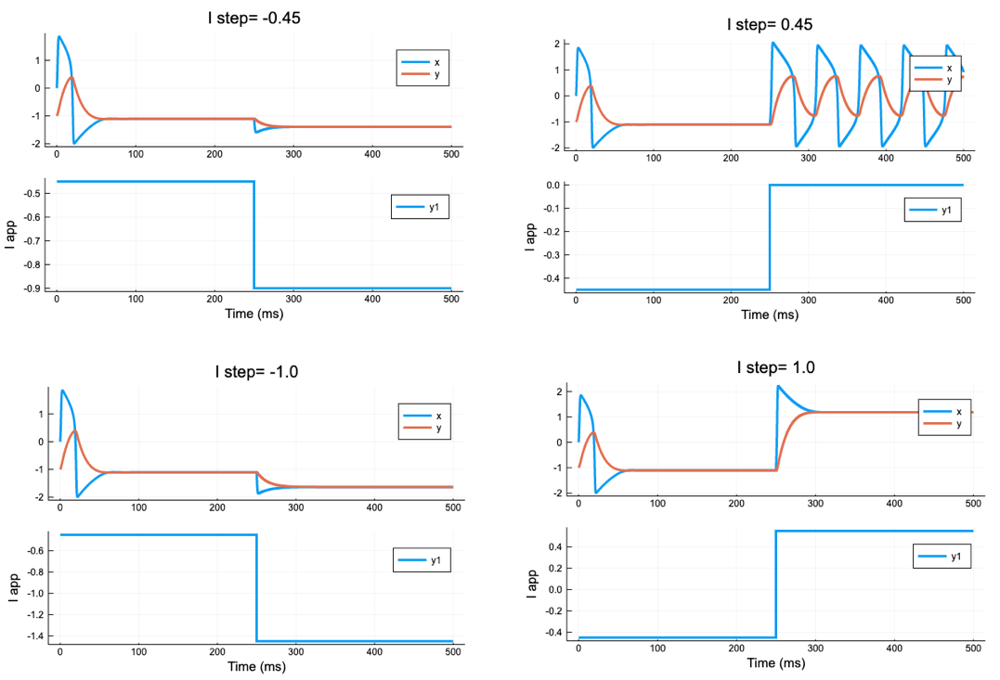

__Simulation of current steps applied to the neuronal model of FHN. The initial condition of the system is $I = -0.45$ in all cases. The step arrival time is $t_{step} = 250 ms$; the only parameter that changes is the applied step current ($I_{step}$).__
<br>_Note: The y axis of the "spike" graph represents Voltage (mV)._
<br><br>
We can see that in the case of $I_{step} = -0.45$ (upper left), at the beginning we see a spike due to the initial conditions of the system (as in all cases), and then a hyperpolarization upon arrival of the pulse, that is, a decrease in the membrane voltage. This is because we went from being in $I_{app} = -0.45$ to $I_{app} = -0.9$.
In the graph of $I_{step} = 0.45$ (upper right), after the resting state and at the arrival of the step, sustained spikes are generated throughout the pulse. This occurs by adding positive current to the system that pushes it to depolarization.
In the graph of $I_{step} = -1.0$ (lower left), we observe the same effect as in $I_{step} = -0.45$, but the hyperpolarization is slightly higher, this because we bring the membrane potential (mV) to more negative values. This happens because we go from $I_{app} = -0.45$ (initial conditions) to $I_{app} = -1.4$.
Finally, in the graph of $I_{step} = 1.0$ (lower right), we can observe that when the step arrives there is an initial depolarization that, because the injected current is large and sustained, is maintained over time. In this case, the system cannot be repolarized and loses its resting state.

## 2.2 Train of current pulses

In [36]:
###Función para el tren de pulsos
function TRAIN(t, freq, Istep, DC)
    if DC==0 
        train=(sign(sin(2*pi*freq*t)*DC)/2)*Istep  #Si el DC =0, que todo se multiplique por 0, ya que significa que no existen pulsos
    elseif DC==1
        train= (sign(t)+1)/2*Istep #Cuando el DC es 1, significa que el step sube en el inicio y se queda arriba todo el experimento
    elseif DC<0.5
        train= (sign(sin(2*pi*freq*t)+(DC-1))/2)*Istep  #Cuando el valor DC<0.5, hay que restarle 1 porque p.e. si ponemos DC=0.2 el tren lo interepreta como DC=0.8
    elseif DC>0.5
        train= (sign(sin(2*pi*freq*t)+(DC))/2)*Istep #Cuando el valor del DC >0.5, se queda igual
    elseif DC==0.5
        train=(sign(sin(2*pi*freq*t))/2)*Istep  #Si DC=0.5, entonces no se le debe agregar nada al seno, ya que el tren sera periodico, ie estara 0.5 abajo y 0.5 de tiempo arriba
    end
    return train
end

TRAIN (generic function with 1 method)

In [37]:
T=500  
dt=0.001  
Nt=convert(Int64,T/dt)+1  
t=range(0,T,length=Nt) 

function FHNeulerTRAIN(I, ε, x0, y0, freq, Istep, DC)   
    """Función para resolver las ec. FHN con euler, 
    con la capacidad de aplicar trenes de pulsos de corriente
    Argumentos:
    I= corriente aplicada inicial
    ε= variable que controla la "velocidad" de evolución de y
    x0= condición inicial del sistema en x
    y0= condición inicial del sistema en y
    tstep= tiempo en el cual se dará el pulso de corriente
    Istep= corriente del pulso
    """
    x=zeros(Nt,1)
    y=zeros(Nt,1)
    x[1]=x0  
    y[1]=y0
    for i=2:Nt
        tin= i*dt
        x[i]=x[i-1]+dt*(-(x[i-1]^3)/3+x[i-1]-y[i-1]+ I+TRAIN(tin, freq, Istep, DC))
        y[i]=y[i-1]+dt*ε*(x[i-1]-y[i-1])
    end
    return x,y
end

FHNeulerTRAIN (generic function with 1 method)

In [38]:
T=500.0
tspan=(0.0,T)

Istep= 0.3 #Corriente del pulso

I= -0.45 #En 0.3147 esta la bifurcacion de Hopf
ε= 0.05

x0= 0.0
y0= -1.0
freq= 0.01
DC= 0.5

p=(I,ε)

@time x,y= FHNeulerTRAIN(I, ε, x0, y0, freq, Istep, DC);

  0.749893 seconds (18.55 M allocations: 300.150 MiB, 6.85% gc time)


In [39]:
#plot1= plot(t,x,label="x", linewidth=3)
#plot1= plot!(t,y,label="y", linewidth=3)
#plot2= plot(t, I.+TRAIN.(t, freq, Istep, DC), linewidth=3, title="DC=0.5, freq=0.01, I step=0.3", xlabel="Time(ms)", ylabel="I app")
    
#plot(plot1, plot2, layout=(2,1))

#Comenté esta parte del código porque enseguida agrego las gráficas obtenidas mediante diferentes simulaciones

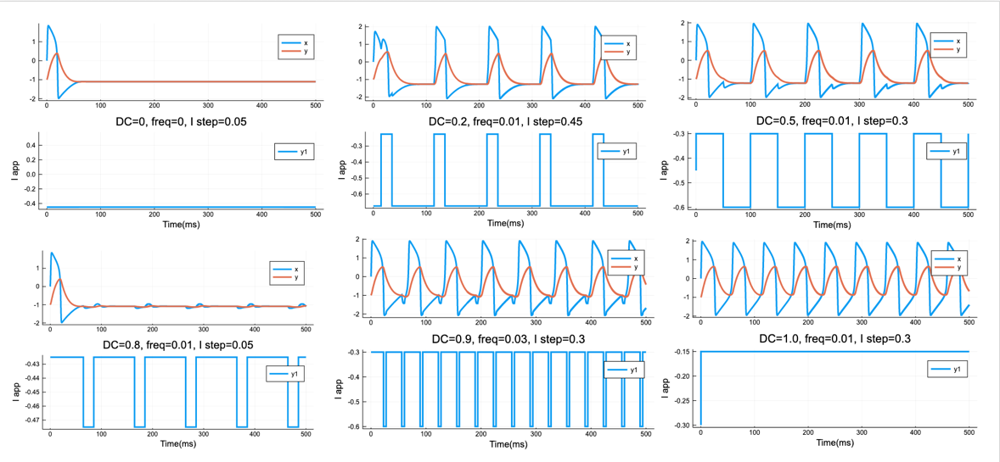

__Simulations of current pulse trains applied to the FHN neural model. The base current is $I = -0.45$ in all cases .__
<br>
 -  In the first figure (upper left) the train has a Duty Cycle (DC) of 0, that is, the train does not exist, that's why we only observe the initial (base) spike and then the system remains at the resting state.
 - In the second figure (upper center) the $DC = 0.2$, the $Frequency (freq) = 0.01$ and the pulse current is 0.45, this duty cycle indicates that the train will pass a fraction of 0.2 of each cycle above and 0.8 below, this same logic applies for all DCs. We can see that in the first spike (the basal), there is a double peak of activity because the first pulse of the train "interrupts" it, then, we can see that with each arrival of the pulse there is a typical spike.
 - In the third figure (upper right) the $DC = 0.5$, that is, the same fraction of time above as below, $freq = 0.01$ and $I_{step} = 0.3$. We can see that the figure is very similar to the previous one, although the spike is slightly wider in this case and there is a rebound-like phenomenon in the resting state. This phenomenon could be due the frequency of the pulses does not allow the system to transit from one spike to another in a "typical" way. We can also conclude that with $I_{step} = 0.3$ it's also possible to depolarize the neuron.
 - In the fourth figure (lower left), $DC = 0.8$, $freq = 0.01$ and $I_{step} = 0.05$. We can see that with this injected current it is not possible to remove the neuron from the resting state, only small oscillations are evoked at the start of each pulse.
 - In the fifth figure (lower center), $DC = 0.9$, $freq = 0.03$ and $I_{step} = 0.3$. We can see a different behavior from the other graphs, that is, there are more pulses in the same amount of time due to the increase in the frequency parameter. The pulse is depolarizing so there are spikes periodically although there is a negative rebound-like at the start of each spike, I infer that this is due to the frequency of the train.
 - Finally, the sixth figure (lower right) $DC = 1.0$, $freq = 0.01$ and $I_{step} = 0.3$. This duty cycle tells us that the train will run all the way up from the beginning of the current injection. Given the depolarizing current pulse ($I_{step} = 0.3$) and the initial conditions of the system ($I = -0.45$) the neuron is capable of exhibiting a stable periodic firing-rest dynamics.

***
# Part 3: Rebound spike
>Use phase portrait analysis to explain why the model responds with a rebound spike to negative current pulses.

The question that gave rise to this phenomenon is that if excitatory inputs depolarize the membrane potential, ie bring the neuron closer to its firing threshold, and the inhibitory inputs hyperpolarize the potential and move it away from said threshold, then how is it neurons can fire in response to inhibitory inputs?
<br>_Example of the described phenomena in a rat's brainstem neuron:_
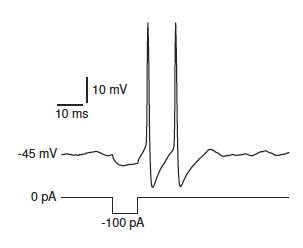
<br>This phenomenon is observd in th FHN model and it is called anodal break excitation, ___rebound spike___ or postinhibitory spike. 
<br>Many biologists say that rebound responses are due to the activation and inactivation of certain slow currents, which bring the membrane potential over the threshold. The problem with this explanation is that neither the FHN model nor the neuron in the above figure has these currents, and even if they did, the hyperpolarization is too short and too weak to affect them.

The following GIF shows the Anodal break excitation (__post-inhibitory rebound spike__) in the FitzHugh-Nagumo model, taken from Eugene M. Izhikevich and Richard FitzHugh (2006), Scholarpedia, 1(9):1349.
<br><br>
As the stimulus $I$ becomes negative (hyperpolarization), the resting state shifts to the left. As the system is released from hyperpolarization, the trajectory starts from a point far below the resting state, makes a large-amplitude excursion, i.e. fires a transient spike, and then returns to the resting state.

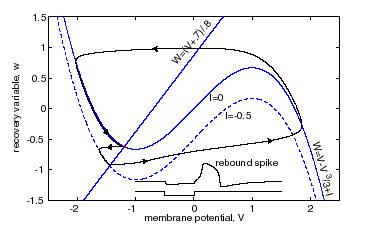

In [60]:
T=500.0
tspan=(0.0,T)

Istep= 0.3 #Corriente del pulso

I= -0.45 #En 0.3147 esta la bifurcacion de Hopf
ε= 0.05

x0= 0.0
y0= -1.0
freq= 0.01
DC= 0.5

p=(I,ε)

@time x,y= FHNeulerTRAIN(I, ε, x0, y0, freq, Istep, DC);

  0.692248 seconds (18.50 M allocations: 297.477 MiB, 7.24% gc time)


In [67]:
X = -3:0.1:3
Y = -3:0.1:3
Xnullcline(X,Y)=-X^3/3+X-Y+I
Xnullcline2(X,Y)=-X^3/3+X-Y+(I-Istep)
Ynullcline(X,Y)=X-Y

p1= plot(t,x, linewidth=3, xlabel="Time (ms)", ylabel="Voltage (mV)", label=false, xlim= (228,340))
p2=plot(x, y, lw=2, xlabel="x", ylabel="y", label=false)
p3=plot(x, y,label="(x(t),y(t))",xlabel="x",ylabel="y", xlim=(-3.0, 3), linewidth= 3)
p3=contour!(X,Y,Xnullcline,levels=[0])
p3=contour!(X,Y,Xnullcline2,levels=[0], ls= :dash)
p3=contour!(X,Y,Ynullcline,levels=[0],colorbar=false, color= "green")
    
plot(p1,p2,p3, layout=(1,3), size=(980,320))

Ynullcline (generic function with 1 method)

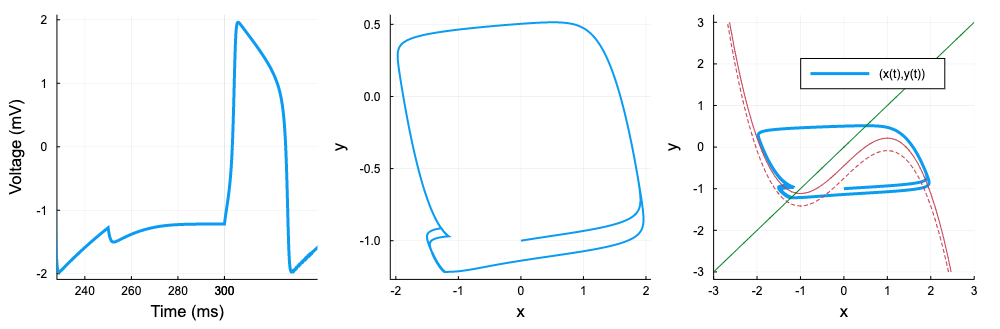

__Simulation of the rebound spike phenomenon in the FHN model.__
<br>
The first figure (left) is the simulation of the rebound spike in response to a short hyperpolarizing pulse. The figure in the center corresponds to the evolution of the variables $x$ and $y$ over time. Finally, the third figure shows the phase portrait of the FHN model: the dynamic $x(t), y(t)$ is shown in blue, the solid red nullcline corresponds to $I = -0.45$, and the dotted red nullcline corresponds to $I = -0.6$.
<br><br>
__Phase portrait analysis.__
<br>
Our system starts at the solid nullcline (original resting state, $I = -0.45$), then the hyperpolarizing stimulus arrives (step up), causing the resting state to shift to the left, i.e. brings the system to the dashed nullcline ($I = -0.6$). When the hyperpolarizing pulse is removed (step down), the trajectory starts in the new resting state ($-0.6$), then travels the orbit corresponding to a spike and returns to its original resting state ($-0.45$). In this case, since the simulation was done with a train of pulses, several trajectories are seen in the phase portrait.

***
# Part 4: Ramps
>Modify the code to be able to apply ramps of applied current with variable speed.

In [68]:
recta(pendiente, t, tstart)=pendiente*(t - tstart)  
#recta es la función que permite modificar la velocidad de la rampa, através del argumento "pendiente"

RAMP(t, tstart, pendiente)=STEP(t, tstart, 1.0)* recta(pendiente, t, tstart)

RAMP (generic function with 1 method)

In [69]:
T= 1300.0 
dt=0.001  
Nt=convert(Int64,T/dt)+1  
t=range(0,T,length=Nt) 

function FHNeulerRAMP(I, ε, x0, y0, tstart, pendiente)   
    """Función para resolver las ec. FHN con euler, 
    con la capacidad de aplicar rampas de corriente
    Argumentos:
    I= corriente aplicada inicial
    ε= variable que controla la "velocidad" de evolución de y
    x0= condición inicial del sistema en x
    y0= condición inicial del sistema en y
    tstart= el tiempo en el que se da la rampa, es equivalente a tstep
    pendiente= valor de la pendiente de la rampa
    """
    x=zeros(Nt,1)
    y=zeros(Nt,1)
    x[1]=x0  
    y[1]=y0
    for i=2:Nt
        tin= i*dt
        x[i]=x[i-1]+dt*(-(x[i-1]^3)/3+x[i-1]-y[i-1]+I+ RAMP(tin, tstart, pendiente))
        y[i]=y[i-1]+dt*ε*(x[i-1]-y[i-1])
    end
    return x,y
end

FHNeulerRAMP (generic function with 1 method)

In [80]:
T=1300.0

tstart= 50.0
pendiente= 0.001

I= -0.45
ε= 0.05

x0= 0.0
y0= -1.0

p=(I,ε)

@time x,y= FHNeulerRAMP(I, ε, x0, y0, tstart, pendiente);

  1.647592 seconds (46.80 M allocations: 753.714 MiB, 7.15% gc time)


In [89]:
#plot1= plot(t,x,label="x", linewidth=3)
#plot1= plot!(t,y,label="y", linewidth=3)
#plot2= plot(t, I.+RAMP.(t, tstart, pendiente), linewidth=3, title="m= 0.001, I start= -0.6", xlabel="Time (ms)", ylabel= "I app" )

#plot(plot1, plot2, layout=(2,1))

#Comenté esta parte del código porque enseguida agrego las gráficas obtenidas mediante diferentes simulaciones

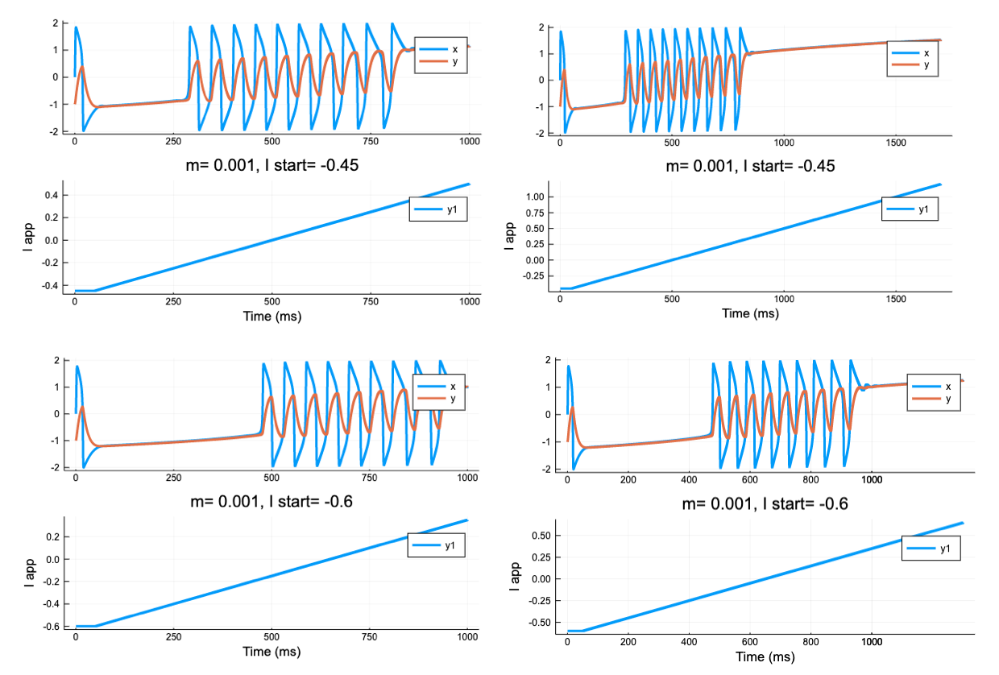

## 4.1 BONUS: Excitation block in the FHN model 

The excitation block is a phenomenon presented in many neurons in a physiological way. It consists of the cessation of repetitive spiking as the amplitude of the applied current increases.

__The excitation block phenomenon in a rat's neuron and in a simulation of the FHN model.__ The top figure shows that the spiking activity of the rat's neuron is blocked by strong excitation (i.e., injecting a strong depolarizing current), taken form Izhikevich, 2007. The figure below shows the same phenomenon in my simulation of the FHN model with an ramp of injected current. Ramp parameters: $m=0.001$, $I_{start} = -0.6$.
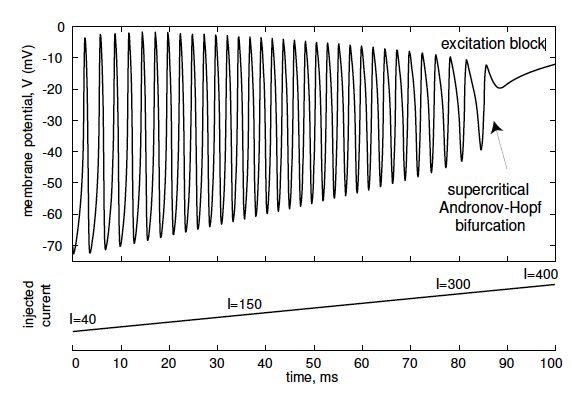
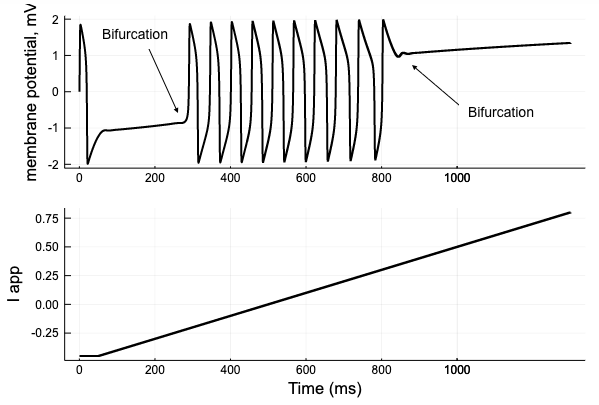

### Phase portrait of the excitation block

In [79]:
X = -3:0.1:3
Y = -3:0.1:3

#Xnullcline(X,Y)=-X^3/3+X-Y+I Esta es la que empieza en -0.6, pero preferí quitarla por estética
Xnullcline2(X,Y)=-X^3/3+X-Y+0
Xnullcline3(X,Y)=-X^3/3+X-Y+0.3147
Xnullcline4(X,Y)=-X^3/3+X-Y-0.3147
Ynullcline(X,Y)=X-Y

plot(x,y, linewidth=2, xlabel="x", ylabel="y", label=false)
contour!(X,Y,Xnullcline,levels=[0])
contour!(X,Y,Xnullcline2,levels=[0], color="orange")
contour!(X,Y,Xnullcline3,levels=[0], color="black")
contour!(X,Y,Xnullcline4,levels=[0], color="purple")
contour!(X,Y,Ynullcline,levels=[0],colorbar=false, color="green")

Ynullcline (generic function with 1 method)

__Phase portrait analysis of the excitation block phenomenon in the FHN model.__
<br> The figure on the left shows the phase portrait corresponding to the simulation of the excitation block of the FHN model with a ramp of applied current shown in the previous cell. The gif on the right shows the phase portrait of the excitation block through time, taken from Eugene M. Izhikevich and Richard FitzHugh (2006), Scholarpedia, 1(9):1349.

<table><tr>
<td> <img src="Excitation_block.png" style="width:600px"> <td/>
<td> <img src="Hopf2Hopf.gif" style="width:600px"> <td/>
</tr></table>

When the current $I$ is low ($I_{RS} = -0.45$), the equilibrium (intersection of nullclines) is in the left arm of the x-nullcline (stable), therefore the system is in its resting state. Increasing $I$ moves the x-nullcline upwards reaching the supercritical Hopf bifurcation ($I_{Hopf} = -0.3147$, purple), i.e., the appearance of a stable limit cycle from the disappearance of a stable equilibrium.
If we continue to increase the current ($I_{Osc} = 0.0$, orange) and therefore keep pushing the nullcline upward, the equilibrium slides towards the middle branch (unstable). In this case the model exhibits oscillations, ie, periodic spiking. Increasing the applied current further moves the equilibrium to the right branch of the nullcline (stable), and the spiking activity is blocked (by excitation). The disappearance of this limit cycle occurs via another supercritical Hopf bifurcation ($I_{Hopf} = 0.3147$, black).
<br>
In this way, the FHN model can exhibit two Hopf bifurcations in response to ramping up of the injected current, the one leading to the apperance of periodic spiking activity ($I_{Hopf} = -0.3147$), and the one leading to its disappearance ($I_{Hopf} = 0.3147$).

***
# Part 5: Stochastic Simulations
>(Optional) Modify the code to run stochastic simulations. Suggestion: Modify the Euler version.

To add "white noise" in a neural model, the Gaussian random number function is used, that is, with distribution centered at 0 and variance of 1.
- randn() is the function of Gaussian numbers, multiplying it by Dx or Dy changes the variance and thus the noise that we add to the function is generated.

In [90]:
function FHNeulerStochastic(Dx,Dy,I,ε,x0,y0)
    x=zeros(Nt,1)
    y=zeros(Nt,1)
    x[1]=x0
    y[1]=y0
    for i=2:Nt
        x[i]=x[i-1]+dt*(-(x[i-1]^3)/3+x[i-1]-y[i-1]+I+Dx*randn(1)[1])
        y[i]=y[i-1]+dt*ε*(x[i-1]-y[i-1]+Dy*randn(1)[1])
    end
    return x,y
end

FHNeulerStochastic (generic function with 1 method)

In [91]:
I=-0.45

ε=0.05
        
x0=0.0 #randn(1)[1]  Condiciones iniciales random
y0=-1.0  #randn(1)[1]

Dx= 4.0 #Con Dx > 1.8 en FHN hay umbral y se generan spikes de manera aleatoria
Dy=0.5

@time x,y=FHNeulerStochastic(Dx,Dy,I,ε,x0,y0);

  2.117302 seconds (48.18 M allocations: 976.267 MiB, 6.14% gc time)


In [92]:
#plot(t,x,label="x", xlabel="Time (ms)", title="Stochastic simulation, Dx= 1.2 and Dy= 0.5")
#plot!(t,y,label="y")

#Comenté esta parte del código porque enseguida agrego las gráficas obtenidas mediante diferentes simulaciones

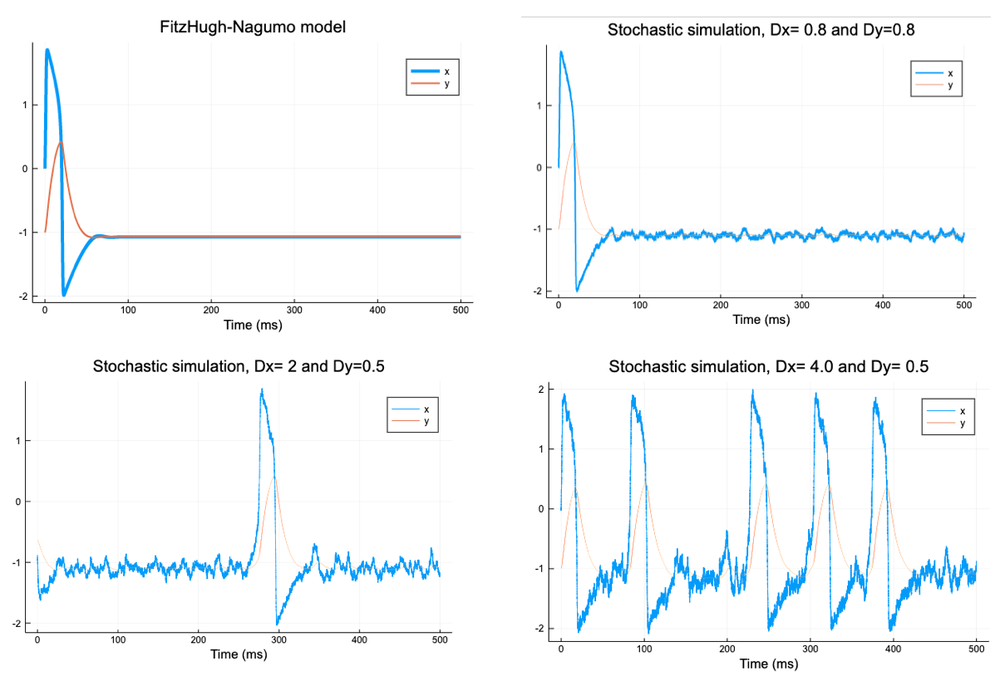